In [1]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import time
import numpy as np
import matplotlib.pyplot as plt
import spacy

In [2]:
!python -m spacy download el_core_news_sm

2023-06-07 19:36:24.425661: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.6/12.6 MB 52.4 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('el_core_news_sm')


In [3]:
start_page = 2
end_page = 5

start_url = 'https://www.tovima.gr/category/world/page/'

test_url = start_url + str(start_page)

test_url

'https://www.tovima.gr/category/world/page/2'

In [4]:
response = requests.get(test_url)
doc = BeautifulSoup(response.text, 'html.parser')

In [5]:
teaser_articles_list = doc.find('div', {'class': 'columns is-variable is-multiline is-4-desktop'}).find_all('div', {'class': 'column is-full wrap-category-row'})

In [6]:
teaser_articles_list[0]

<div class="column is-full wrap-category-row">
<div class="simple-row">
<a class="columns is-mobile is-multiline" href="https://www.tovima.gr/2023/06/06/world/oukrania-poioi-oi-kindynoi-meta-tin-ekriksi-sto-fragma-einai-egklima-polemou/">
<div class="column is-2-desktop is-2-tablet is-2-mobile is-full-small">
<time class="line-height-1 mr-3 post-date updated manrope is-size-5 semigrey-c">
        06.06.2023, 15:10      </time>
</div>
<div class="column is-6-desktop is-6-tablet is-6-mobile is-full-small">
<div class="wrap-row-header-n-desk">
<h3 class="o-head f-400 my-0 is-size-2 zonabold">
        Ουκρανία: Ποιοι οι κίνδυνοι μετά την έκρηξη στο φράγμα - Τι θέση παίρνει η Ευρώπη      </h3>
<p class="is-size-normal mb-0 mt-4 text-ellipsis text-ellipsis-4 grey-c line-height-1-3">
        Το γιγαντιαίο φράγμα Καχόβκα στη νότια Ουκρανία έχει πλημμυρίσει ήδη μεγάλες εκτάσεις στη Χερσώνα, ενώ υπάρχει κίνδυνος για 16.000 ανθρώπους - Εκατοντάδες οι εκκενώσεις σπιτιών στην περιοχή      </p>
<div

In [7]:
article_link = teaser_articles_list[0].find('a', {'class': 'columns is-mobile is-multiline'})['href']

article_link

'https://www.tovima.gr/2023/06/06/world/oukrania-poioi-oi-kindynoi-meta-tin-ekriksi-sto-fragma-einai-egklima-polemou/'

In [8]:
teasers_list = []

for page_num in range(start_page, end_page+1):
  page_url = start_url + str(page_num)
  response = requests.get(page_url)
  doc = BeautifulSoup(response.text, 'html.parser')
  teaser_articles_list = doc.find('div', {'class': 'columns is-variable is-multiline is-4-desktop'}).find_all('div', {'class': 'column is-full wrap-category-row'})

  for teaser in teaser_articles_list:
      story_dict = {}
      try:                
        link = teaser.find('a', {'class': 'columns is-mobile is-multiline'})['href']        
        if link.startswith("http"):
          story_dict['url'] = link
        else:
          story_dict['url'] = main_url + link
      except:
        story_dict['url'] = ''
        pass
      teasers_list.append(story_dict)
  time.sleep(1)

In [9]:
tovima_teasers_df = pd.DataFrame(teasers_list)
tovima_teasers_df

,url
0,https://www.tovima.gr/2023/06/06/world/oukrani...
1,https://www.tovima.gr/2023/06/06/world/tourkia...
2,https://www.tovima.gr/2023/06/06/world/einai-p...
3,https://www.tovima.gr/2023/06/06/world/papas-f...
4,https://www.tovima.gr/2023/06/06/world/sygkrou...
...,...
75,https://www.tovima.gr/2023/05/31/world/steit-n...
76,https://www.tovima.gr/2023/05/31/world/isxyros...
77,https://www.tovima.gr/2023/05/30/world/atyxima...
78,https://www.tovima.gr/2023/05/30/world/tourkik...


In [10]:
tovima_teasers_df.to_csv('/content/temp/tovima_teasers_world.csv', index=False)

In [11]:
article_url = 'https://www.tovima.gr/2023/06/04/world/oukrania-i-mosxa-leei-oti-apothise-tin-epithesi-filooukranon-doliofthoreon-sto-mpelgkoront/'

In [12]:
response = requests.get(article_url)
doc = BeautifulSoup(response.text, 'html.parser')

In [13]:
article = doc.find('article', {'class': 'columns is-relative is-variable is-4-desktop is-multiline brief-content'})
article

<article class="columns is-relative is-variable is-4-desktop is-multiline brief-content"><div class="column is-full is-relative"><div class="wrap-article-header"><div class="columns"><div class="column is-narrow is-hidden-touch"><div class="half-width"><div class="wrap-post-category"> <a class="parent-category" href="https://www.tovima.gr/category/world/">Κόσμος </a></div></div></div><div class="column"><header class="article-header"><h1 class="f-400 post-title zonaultra is-size-1-desktop is-size-2-mobile is-size-2-tablet"> Ουκρανία: Η Μόσχα λέει ότι απώθησε την επίθεση φιλοουκρανών «δολιοφθορέων» στο Μπέλγκοροντ</h1><h2 class="post-summary zonabold is-visible-small"> Οι ρωσικές δυνάμεις απώθησαν, χρησιμοποιώντας το πυροβολικό τους, την εισβολή μιας ομάδας φιλοουκρανών «δολιοφθορέων».</h2></header></div></div></div></div><div class="column is-narrow is-hidden-touch"><div class="half-width is-relative full-height"><div class="post-meta-wrap-r post-meta"><div class="post-meta-r2"> <time 

In [14]:
section = doc.find('a', {'class': 'parent-category'}).text
section

'Κόσμος '

In [15]:
title = doc.find('h1').text
title

' Ουκρανία: Η Μόσχα λέει ότι απώθησε την επίθεση φιλοουκρανών «δολιοφθορέων» στο Μπέλγκοροντ'

In [16]:
date = doc.find('time', {'class': 'line-height-1 post-date manrope'})['datetime']
wra = doc.find('time', {'class': 'line-height-1 post-date manrope lightgrey-c'}).text
datetime = date + ' ' + wra
datetime

'04-06-2023 20:12'

In [17]:
author = doc.find('span', {'class': 'vima-author'}).text
author

' Newsroom '

In [18]:
paragraphs = doc.find('div', {'class': 'post-body main-content pos-rel article-wrapper'}).find_all('p')
paragraphs

[<p>Οι ρωσικές δυνάμεις απώθησαν, χρησιμοποιώντας το πυροβολικό τους, την εισβολή μιας ομάδας φιλοουκρανών «δολιοφθορέων», μετέδωσε το ρωσικό πρακτορείο Interfax, επικαλούμενο το υπουργείο Άμυνας της <a href="https://www.tovima.gr/tag/%cf%81%cf%89%cf%83%ce%af%ce%b1/" rel="noopener" target="_blank">Ρωσίας</a>.<p>Λίγο νωρίτερα, ο κυβερνήτης της περιφέρειας Μπέλγκοροντ, που συνορεύει με την Ουκρανία, <a href="https://www.tovima.gr/2023/06/04/world/rosia-kyvernitis-mpelgkoront-dieksagontai-maxes-me-oukranous-sampoter-se-methoriaki-poli/" rel="noopener" target="_blank">ανέφερε ότι διεξάγονταν μάχες στη μεθοριακή πόλη Νόβαγια Ταβολζάνκα. </a><div class="floated-div;margin:3rem auto" id="300x250_m1" style="display: none"> <script type="text/javascript">googletag.cmd.push(function() { googletag.display('300x250_m1'); });</script></div><p>Σύμφωνα με τον Βιατσεσλάβ Γκλαντκόφ, οι δράστες είναι Ρώσοι που μάχονται στο πλευρό των Ουκρανών και έχουν αιχμαλωτίσει δύο στρατιώτες, προτείνοντας να τους α

In [19]:
p_texts_list = []
paragraphs = doc.find_all('p')
for p in paragraphs:
  p_texts_list.append(p.text)
full_text = ' '.join(p_texts_list)
full_text = "".join(full_text.splitlines())
full_text

'Οι ρωσικές δυνάμεις απώθησαν, χρησιμοποιώντας το πυροβολικό τους, την εισβολή μιας ομάδας φιλοουκρανών «δολιοφθορέων», μετέδωσε το ρωσικό πρακτορείο Interfax, επικαλούμενο το υπουργείο Άμυνας της Ρωσίας.Λίγο νωρίτερα, ο κυβερνήτης της περιφέρειας Μπέλγκοροντ, που συνορεύει με την Ουκρανία, ανέφερε ότι διεξάγονταν μάχες στη μεθοριακή πόλη Νόβαγια Ταβολζάνκα.  Σύμφωνα με τον Βιατσεσλάβ Γκλαντκόφ, οι δράστες είναι Ρώσοι που μάχονται στο πλευρό των Ουκρανών και έχουν αιχμαλωτίσει δύο στρατιώτες, προτείνοντας να τους ανταλλάξουν για μια συνάντηση μαζί του. «Το μοναδικό πράγμα που με εμποδίζει να διαπραγματευτώ μαζί τους είναι ότι οι άνδρες μας που έχουν στα χέρια τους ίσως να είναι ήδη νεκροί… Αλλά αν δεν είναι, μπορούν να πάνε μεταξύ 17.00-18.00 (τοπική ώρα και ώρα Ελλάδας) στο φυλάκιο του Σεμπέκινο. Εγγυώμαι την ασφάλειά τους» έγραψε σε ανάρτησή του στο Telegram.Το πρωί ο κυβερνήτης κάλεσε τους κατοίκους της περιοχής να εγκαταλείψουν αυτή τη ζώνη στην οποία τις τελευταίες ημέρες έχουν εν

In [20]:
tovima_teasers_df = pd.read_csv('/content/temp/tovima_teasers_world.csv')
tovima_teasers_df.head()

,url
0,https://www.tovima.gr/2023/06/06/world/oukrani...
1,https://www.tovima.gr/2023/06/06/world/tourkia...
2,https://www.tovima.gr/2023/06/06/world/einai-p...
3,https://www.tovima.gr/2023/06/06/world/papas-f...
4,https://www.tovima.gr/2023/06/06/world/sygkrou...


In [22]:
full_articles_list = []

for article_url in tovima_teasers_df['url']:
  response = requests.get(article_url)
  doc = BeautifulSoup(response.text, 'html.parser')

  article = doc.find('article', {'class': 'columns is-relative is-variable is-4-desktop is-multiline brief-content'})

  full_article_dict = {}
  
  full_article_dict['site'] = "tovima.gr"
  
  full_article_dict['url'] = article_url

  try:
    section = doc.find('a', {'class': 'parent-category'}).text
    full_article_dict['section'] = section
  except:
    full_article_dict['section'] = ''
    pass

  try:
    title = doc.find('h1').text
    full_article_dict['title'] = title
  except:
    full_article_dict['title'] = '' 
    pass

  try:
    date = doc.find('time', {'class': 'line-height-1 post-date manrope'})['datetime']
    wra = doc.find('time', {'class': 'line-height-1 post-date manrope lightgrey-c'}).text
    datetime = date + ' ' + wra 
    full_article_dict['datetime'] = datetime
  except:
    full_article_dict['datetime'] = ''
    pass

  try:
    author = doc.find('span', {'class': 'vima-author'}).text
    full_article_dict['author'] = author
  except:
    full_article_dict['author'] = ''
    pass

  try:
    p_texts_list = []                      
    paragraphs = doc.find_all('p')    
    for p in paragraphs:                  
      p_texts_list.append(p.text)      
    full_text = ' '.join(p_texts_list)  
    full_text = "".join(full_text.splitlines())
    full_article_dict['full_text'] = full_text  
  except:
    full_article_dict['full_text'] = '' 
    pass

  full_articles_list.append(full_article_dict)
  time.sleep(1)

In [23]:
tovima_full_articles_df = pd.DataFrame(full_articles_list)
tovima_full_articles_df

,site,url,section,title,datetime,author,full_text
0,tovima.gr,https://www.tovima.gr/2023/06/06/world/oukrani...,Κόσμος,Ουκρανία: Ποιοι οι κίνδυνοι μετά την έκρηξη σ...,06-06-2023 15:10,Newsroom,Μεγάλη ανησυχία έχει προκαλέσει η ανατίναξη το...
1,tovima.gr,https://www.tovima.gr/2023/06/06/world/tourkia...,Κόσμος,Τουρκία: Τα «μυστικά» της κυβέρνησης Ερντογάν...,06-06-2023 15:04,Ιωάννα Κλεφτόγιαννη,Πιο μετριοπαθές; Πιο ισορροπημένο; Πιο αξιόπισ...
2,tovima.gr,https://www.tovima.gr/2023/06/06/world/einai-p...,Κόσμος,Ουκρανία: Είναι πιθανή μια κατάπαυση πυρός ;,06-06-2023 14:09,Newsroom,"Σε αδιέξοδο βρίσκεται, σύμφωνα με άρθρο γνώμης..."
3,tovima.gr,https://www.tovima.gr/2023/06/06/world/papas-f...,Κόσμος,Πάπας Φραγκίσκος: Στο νοσοκομείο ο Ποντίφικας,06-06-2023 13:02,Newsroom,Στο νοσοκομείο Gemelli της Ρώμης εισήχθη ο Πάπ...
4,tovima.gr,https://www.tovima.gr/2023/06/06/world/sygkrou...,Κόσμος,Σύγκρουση τρένων στην Ινδία: 100 πτώματα δεν ...,06-06-2023 12:30,Newsroom,"Περίπου 100 πτώματα, που βρίσκονται σε νοσοκομ..."
...,...,...,...,...,...,...,...
75,tovima.gr,https://www.tovima.gr/2023/05/31/world/steit-n...,Κόσμος,Στέιτ Ντιπάρτμεντ: Οι ΗΠΑ δεν υποστηρίζουν τι...,31-05-2023 08:22,Newsroom,Η κυβέρνηση των ΗΠΑ δεν υποστηρίζει στρατιωτικ...
76,tovima.gr,https://www.tovima.gr/2023/05/31/world/isxyros...,Κόσμος,"Ισχυρός σεισμός 6,2 βαθμών της κλίμακας Ρίχτε...",31-05-2023 07:57,Newsroom,"Σεισμός μεγέθους 6,2 βαθμών της κλίμακας Ρίχτε..."
77,tovima.gr,https://www.tovima.gr/2023/05/30/world/atyxima...,Κόσμος,Ατύχημα στη Ρωσία: Ένας νεκρός και 26 τραυματ...,30-05-2023 22:12,Newsroom,Μια κερκίδα ποδοσφαιρικού γηπέδου κατέρρευσε κ...
78,tovima.gr,https://www.tovima.gr/2023/05/30/world/tourkik...,Κόσμος,Τουρκικές εκλογές: Τα ονόματα που ακούγονται ...,30-05-2023 19:24,Newsroom,Τίποτα δεν είναι ακόμα βέβαιο μετά τις προεδρι...


In [24]:
tovima_full_articles_df.to_csv('/content/temp/tovima_full_articles.csv', index=False)

In [25]:
tovima_full_articles_df['datetime'] = pd.to_datetime(tovima_full_articles_df['datetime'], format='%d-%m-%Y %H:%M')
tovima_full_articles_df

,site,url,section,title,datetime,author,full_text
0,tovima.gr,https://www.tovima.gr/2023/06/06/world/oukrani...,Κόσμος,Ουκρανία: Ποιοι οι κίνδυνοι μετά την έκρηξη σ...,2023-06-06 15:10:00,Newsroom,Μεγάλη ανησυχία έχει προκαλέσει η ανατίναξη το...
1,tovima.gr,https://www.tovima.gr/2023/06/06/world/tourkia...,Κόσμος,Τουρκία: Τα «μυστικά» της κυβέρνησης Ερντογάν...,2023-06-06 15:04:00,Ιωάννα Κλεφτόγιαννη,Πιο μετριοπαθές; Πιο ισορροπημένο; Πιο αξιόπισ...
2,tovima.gr,https://www.tovima.gr/2023/06/06/world/einai-p...,Κόσμος,Ουκρανία: Είναι πιθανή μια κατάπαυση πυρός ;,2023-06-06 14:09:00,Newsroom,"Σε αδιέξοδο βρίσκεται, σύμφωνα με άρθρο γνώμης..."
3,tovima.gr,https://www.tovima.gr/2023/06/06/world/papas-f...,Κόσμος,Πάπας Φραγκίσκος: Στο νοσοκομείο ο Ποντίφικας,2023-06-06 13:02:00,Newsroom,Στο νοσοκομείο Gemelli της Ρώμης εισήχθη ο Πάπ...
4,tovima.gr,https://www.tovima.gr/2023/06/06/world/sygkrou...,Κόσμος,Σύγκρουση τρένων στην Ινδία: 100 πτώματα δεν ...,2023-06-06 12:30:00,Newsroom,"Περίπου 100 πτώματα, που βρίσκονται σε νοσοκομ..."
...,...,...,...,...,...,...,...
75,tovima.gr,https://www.tovima.gr/2023/05/31/world/steit-n...,Κόσμος,Στέιτ Ντιπάρτμεντ: Οι ΗΠΑ δεν υποστηρίζουν τι...,2023-05-31 08:22:00,Newsroom,Η κυβέρνηση των ΗΠΑ δεν υποστηρίζει στρατιωτικ...
76,tovima.gr,https://www.tovima.gr/2023/05/31/world/isxyros...,Κόσμος,"Ισχυρός σεισμός 6,2 βαθμών της κλίμακας Ρίχτε...",2023-05-31 07:57:00,Newsroom,"Σεισμός μεγέθους 6,2 βαθμών της κλίμακας Ρίχτε..."
77,tovima.gr,https://www.tovima.gr/2023/05/30/world/atyxima...,Κόσμος,Ατύχημα στη Ρωσία: Ένας νεκρός και 26 τραυματ...,2023-05-30 22:12:00,Newsroom,Μια κερκίδα ποδοσφαιρικού γηπέδου κατέρρευσε κ...
78,tovima.gr,https://www.tovima.gr/2023/05/30/world/tourkik...,Κόσμος,Τουρκικές εκλογές: Τα ονόματα που ακούγονται ...,2023-05-30 19:24:00,Newsroom,Τίποτα δεν είναι ακόμα βέβαιο μετά τις προεδρι...


In [48]:
tovima_full_articles_df['day'] = pd.DatetimeIndex(tovima_full_articles_df['datetime']).day
tovima_full_articles_df['hour'] = pd.DatetimeIndex(tovima_full_articles_df['datetime']).hour

In [49]:
tovima_full_articles_df

,site,url,section,title,datetime,author,full_text,day,hour
0,tovima.gr,https://www.tovima.gr/2023/06/06/world/oukrani...,Κόσμος,Ουκρανία: Ποιοι οι κίνδυνοι μετά την έκρηξη σ...,2023-06-06 15:10:00,Newsroom,Μεγάλη ανησυχία έχει προκαλέσει η ανατίναξη το...,6,15
1,tovima.gr,https://www.tovima.gr/2023/06/06/world/tourkia...,Κόσμος,Τουρκία: Τα «μυστικά» της κυβέρνησης Ερντογάν...,2023-06-06 15:04:00,Ιωάννα Κλεφτόγιαννη,Πιο μετριοπαθές; Πιο ισορροπημένο; Πιο αξιόπισ...,6,15
2,tovima.gr,https://www.tovima.gr/2023/06/06/world/einai-p...,Κόσμος,Ουκρανία: Είναι πιθανή μια κατάπαυση πυρός ;,2023-06-06 14:09:00,Newsroom,"Σε αδιέξοδο βρίσκεται, σύμφωνα με άρθρο γνώμης...",6,14
3,tovima.gr,https://www.tovima.gr/2023/06/06/world/papas-f...,Κόσμος,Πάπας Φραγκίσκος: Στο νοσοκομείο ο Ποντίφικας,2023-06-06 13:02:00,Newsroom,Στο νοσοκομείο Gemelli της Ρώμης εισήχθη ο Πάπ...,6,13
4,tovima.gr,https://www.tovima.gr/2023/06/06/world/sygkrou...,Κόσμος,Σύγκρουση τρένων στην Ινδία: 100 πτώματα δεν ...,2023-06-06 12:30:00,Newsroom,"Περίπου 100 πτώματα, που βρίσκονται σε νοσοκομ...",6,12
...,...,...,...,...,...,...,...,...,...
75,tovima.gr,https://www.tovima.gr/2023/05/31/world/steit-n...,Κόσμος,Στέιτ Ντιπάρτμεντ: Οι ΗΠΑ δεν υποστηρίζουν τι...,2023-05-31 08:22:00,Newsroom,Η κυβέρνηση των ΗΠΑ δεν υποστηρίζει στρατιωτικ...,31,8
76,tovima.gr,https://www.tovima.gr/2023/05/31/world/isxyros...,Κόσμος,"Ισχυρός σεισμός 6,2 βαθμών της κλίμακας Ρίχτε...",2023-05-31 07:57:00,Newsroom,"Σεισμός μεγέθους 6,2 βαθμών της κλίμακας Ρίχτε...",31,7
77,tovima.gr,https://www.tovima.gr/2023/05/30/world/atyxima...,Κόσμος,Ατύχημα στη Ρωσία: Ένας νεκρός και 26 τραυματ...,2023-05-30 22:12:00,Newsroom,Μια κερκίδα ποδοσφαιρικού γηπέδου κατέρρευσε κ...,30,22
78,tovima.gr,https://www.tovima.gr/2023/05/30/world/tourkik...,Κόσμος,Τουρκικές εκλογές: Τα ονόματα που ακούγονται ...,2023-05-30 19:24:00,Newsroom,Τίποτα δεν είναι ακόμα βέβαιο μετά τις προεδρι...,30,19


In [51]:
tovima_full_articles_df = tovima_full_articles_df.drop(labels=range(0, 6))

In [53]:
tovima_full_articles_df = tovima_full_articles_df.drop(labels=range(77, 79))

In [57]:
tovima_full_articles_df = tovima_full_articles_df.drop(labels=79)

In [58]:
tovima_full_articles_df

,site,url,section,title,datetime,author,full_text,day,hour
6,tovima.gr,https://www.tovima.gr/2023/06/05/world/dania-i...,Κόσμος,Δανία: Η πρωθυπουργός Μέτε Φρεντέρικσεν «δεν ...,2023-06-05 23:49:00,Newsroom,Η πρωθυπουργός της Δανίας Μέτε Φρεντέρικσεν δι...,5,23
7,tovima.gr,https://www.tovima.gr/2023/06/05/world/zelensk...,Κόσμος,Ζελένσκι: Xαιρετίζει «τα νέα που περιμέναμε» ...,2023-06-05 23:17:00,Newsroom,Ο πρόεδρος της Ουκρανίας Βολοντίμιρ Ζελένσκι χ...,5,23
8,tovima.gr,https://www.tovima.gr/2023/06/05/world/tourkia...,Κόσμος,Τουρκία: O Καλίν αναλαμβάνει επικεφαλής των μ...,2023-06-05 21:49:00,Newsroom,Ο πρώην υπεύθυνος επικοινωνίας του Ρετζέπ Ταγί...,5,21
9,tovima.gr,https://www.tovima.gr/2023/06/05/world/aystral...,Κόσμος,Αυστραλία: Η Κάθι Φόλμπιγκ κρίθηκε ένοχη για ...,2023-06-05 20:56:00,Newsroom,"Πριν από 20 χρόνια, μία μητέρα 4 παιδιών στην ...",5,20
10,tovima.gr,https://www.tovima.gr/2023/06/05/world/oukrano...,Κόσμος,Ουκρανοί πίσω από την επίθεση με drone στο Κρ...,2023-06-05 20:33:00,Newsroom,Η Ουκρανία έχει δημιουργήσει ένα δίκτυο πρακτό...,5,20
...,...,...,...,...,...,...,...,...,...
72,tovima.gr,https://www.tovima.gr/2023/05/31/world/kilitsn...,Κόσμος,Κιλιτσντάρογλου: Αίρεται η ασυλία του,2023-05-31 10:42:00,Newsroom,Αίρεται η ασυλία του Κεμάλ Κιλιτσντάρογλου που...,31,10
73,tovima.gr,https://www.tovima.gr/2023/05/31/world/an-anto...,Κόσμος,Αν. Αντόνοφ: Με τη σιωπή τους για την επίθεση...,2023-05-31 10:19:00,Newsroom,Η κυβέρνηση των ΗΠΑ «ενθαρρύνει» την Ουκρανία ...,31,10
74,tovima.gr,https://www.tovima.gr/2023/05/31/world/erntoga...,Κόσμος,Ερντογάν στη πρώτη επικοινωνία με Μπάιντεν: «...,2023-05-31 09:37:00,Newsroom,Την πρώτη επικοινωνία με τον Αμερικανό πρόεδρο...,31,9
75,tovima.gr,https://www.tovima.gr/2023/05/31/world/steit-n...,Κόσμος,Στέιτ Ντιπάρτμεντ: Οι ΗΠΑ δεν υποστηρίζουν τι...,2023-05-31 08:22:00,Newsroom,Η κυβέρνηση των ΗΠΑ δεν υποστηρίζει στρατιωτικ...,31,8


<Axes: >

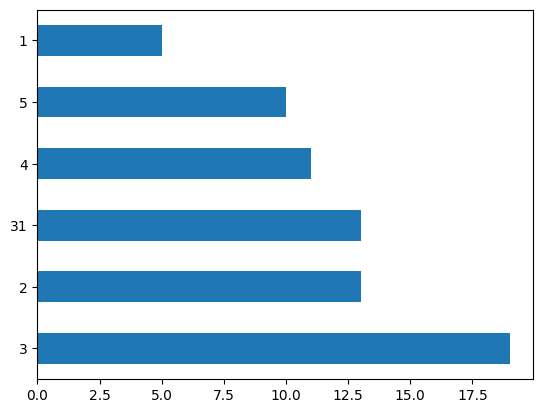

In [68]:
tovima_full_articles_df['day'].value_counts().plot(kind='barh')

<Axes: >

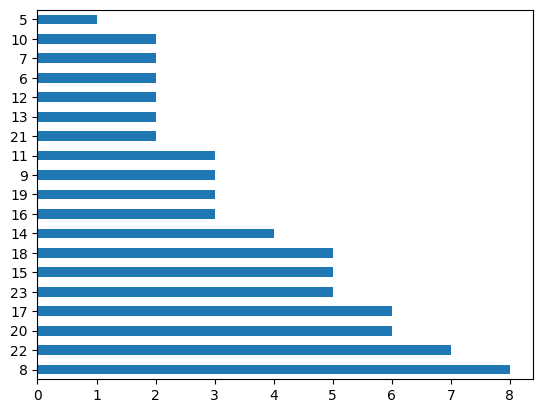

In [67]:
tovima_full_articles_df['hour'].value_counts().plot(kind='barh')

In [61]:
from wordcloud import WordCloud, STOPWORDS

In [70]:
tovima_full_articles_df[tovima_full_articles_df['day']==31]['full_text']

64    Ο Λευκός Οίκος ανακοίνωσε άλλο ένα πακέτο στρα...
65    Η κυβέρνηση του Σι Τζινπίνγκ ανεβάζει ψηλά στη...
66    Η 41χρονη Ιβάνκα, κόρη του πρώην προέδρου των ...
67    Η Ισπανία θα μπορούσε να ακολουθήσει τις ΗΠΑ κ...
68    Δεκάδες χιλιάδες πολίτες είχαν κατέβει στην κε...
69    Μια επιτροπή της NASA, που σχηματίσθηκε πέρυσι...
70    Η Μόσχα «σημείωσε» την «απουσία καταδίκης» της...
71    Την επιθυμία του να υιοθετήσει ο Ρετζέπ Ταγίπ ...
72    Αίρεται η ασυλία του Κεμάλ Κιλιτσντάρογλου που...
73    Η κυβέρνηση των ΗΠΑ «ενθαρρύνει» την Ουκρανία ...
74    Την πρώτη επικοινωνία με τον Αμερικανό πρόεδρο...
75    Η κυβέρνηση των ΗΠΑ δεν υποστηρίζει στρατιωτικ...
76    Σεισμός μεγέθους 6,2 βαθμών της κλίμακας Ρίχτε...
Name: full_text, dtype: object

In [78]:
text31 = tovima_full_articles_df[tovima_full_articles_df['day']==31]['full_text'].str.cat(sep = ' ')

In [73]:
import spacy

In [ ]:
!python -m spacy download el_core_news_sm

In [75]:
nlp = spacy.load('el_core_news_sm')

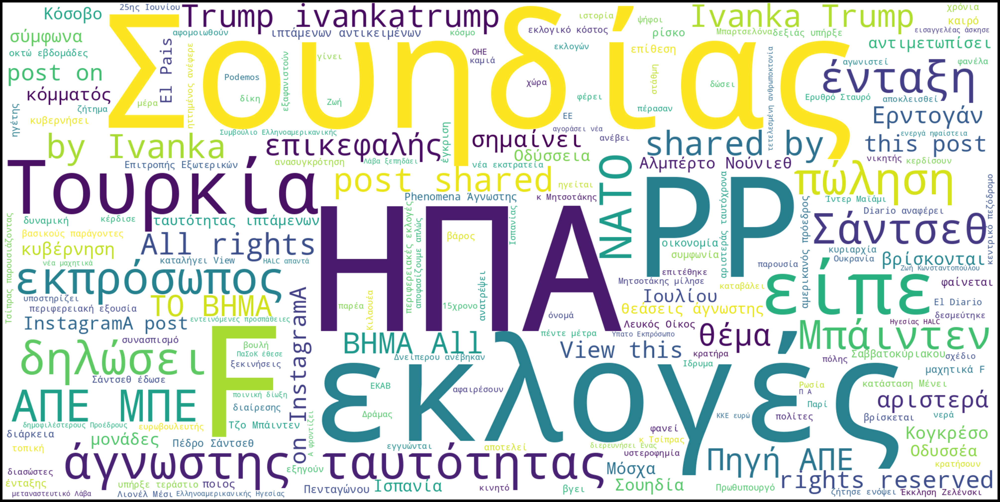

In [76]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'white'
 ).generate(text31)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [79]:
text1 = tovima_full_articles_df[tovima_full_articles_df['day']==1]['full_text'].str.cat(sep = ' ')

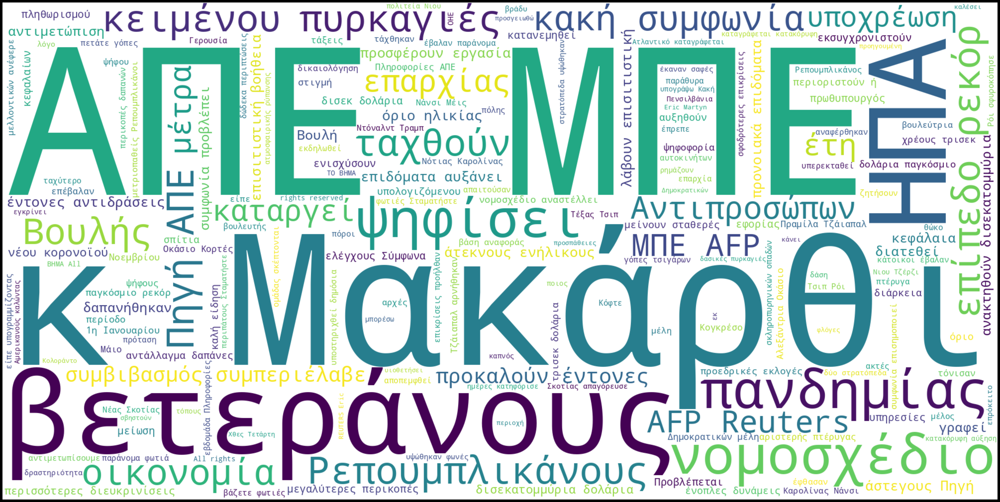

In [80]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'white'
 ).generate(text1)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [81]:
text2 = tovima_full_articles_df[tovima_full_articles_df['day']==2]['full_text'].str.cat(sep = ' ')

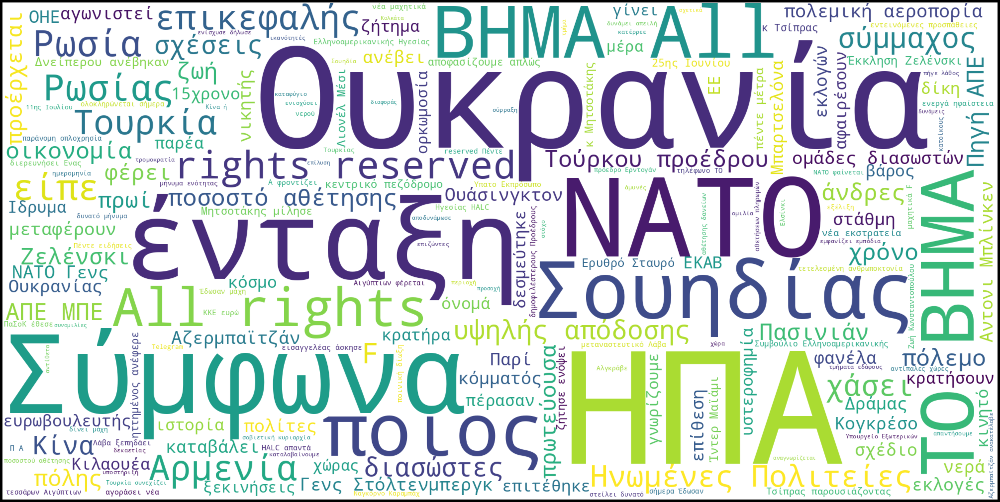

In [82]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'white'
 ).generate(text2)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [83]:
text3 = tovima_full_articles_df[tovima_full_articles_df['day']==3]['full_text'].str.cat(sep = ' ')

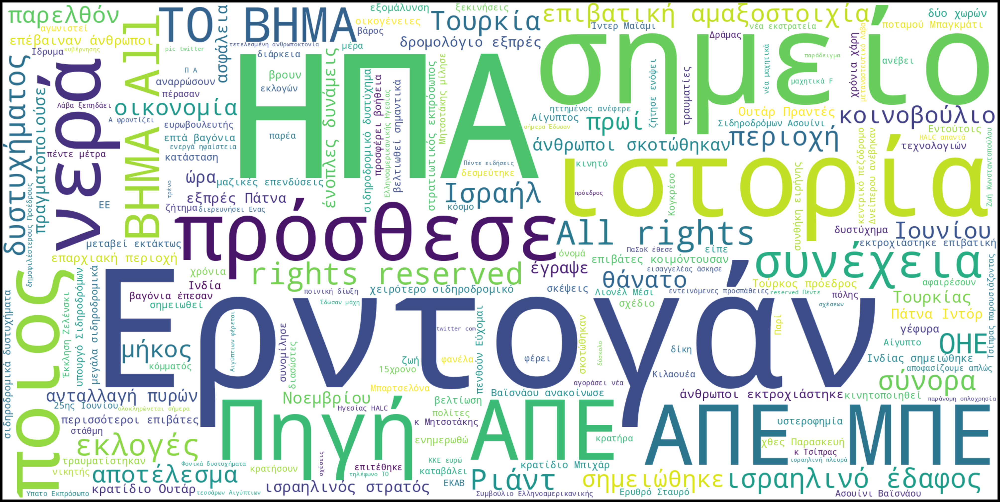

In [84]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'white'
 ).generate(text3)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [85]:
text4 = tovima_full_articles_df[tovima_full_articles_df['day']==4]['full_text'].str.cat(sep = ' ')

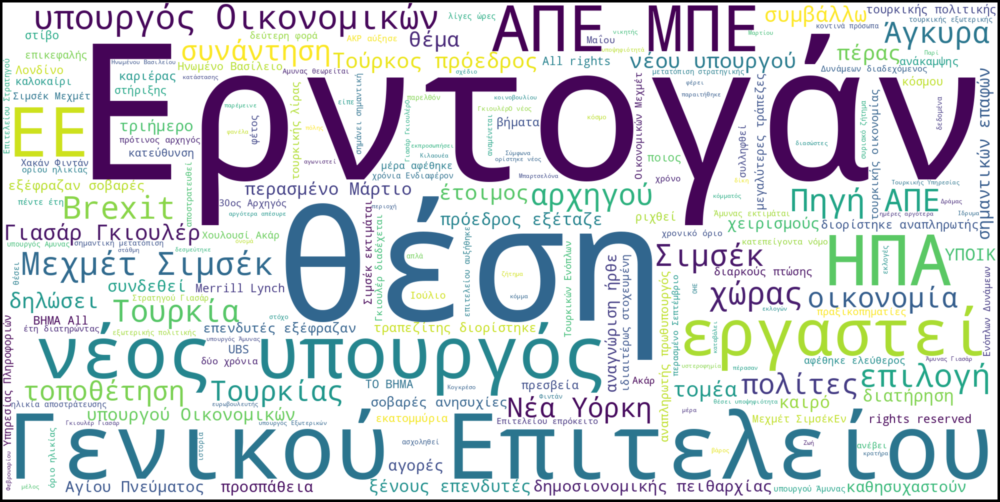

In [86]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'white'
 ).generate(text4)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [87]:
text5 = tovima_full_articles_df[tovima_full_articles_df['day']==5]['full_text'].str.cat(sep = ' ')

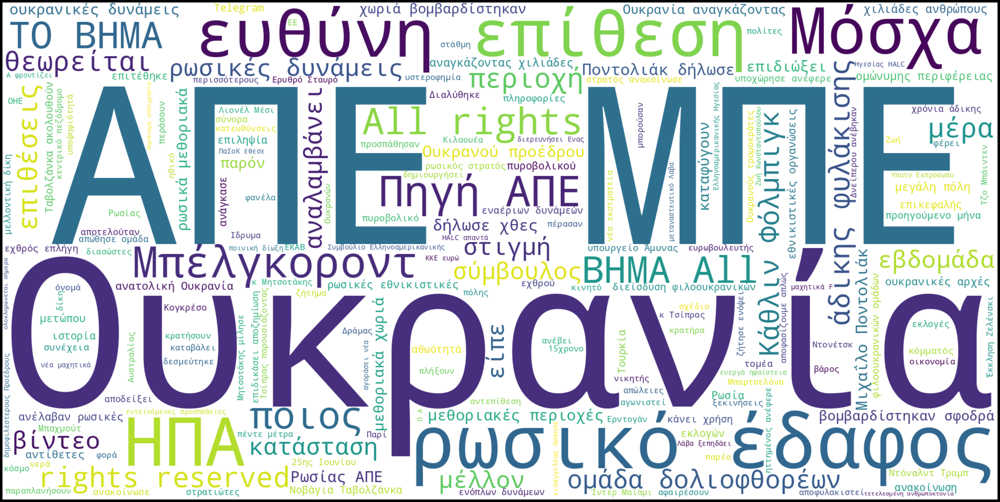

In [88]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'white'
 ).generate(text5)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

**Κύρια ευρήματα**: Στο επίκεντρο των παγκόσμιων ειδήσεων της εφημερίδας ΤΟ ΒΗΜΑ βρίσκονται οι ΗΠΑ, η Ουκρανία και η Τουρκία. Το Σάββατο αναρτήθηκαν τα περισσότερα άρθρα και την Πέμπτη τα λιγότερα. Τα περισσότερα αναρτώνται απογευματινές και βραδινές ώρες με εξαίρεση τις 8 το πρωί.